# Final project Digital Signals Proccesing.

* Julián Mauricio Sanchez Ceballos
* Maverick Sosa




In [ ]:
# For Local run follow the below steps:
# 1. Create a virtual environment by the command
#    python3 -m venv venv
# 2. Activate the virtual environment by the command
#    source venv/bin/activate
# 3. Install the required packages in this code cell by the command
#    %pip install package_name -q


# Required packages
%pip install numpy -q 
%pip install scipy -q
%pip install matplotlib -q
%pip install librosa -q

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [ ]:
# importing the required packages
import numpy as np
import scipy as sp
from scipy import signal, stats 
import matplotlib.pyplot as plt
import librosa
from IPython.display import Audio


from scipy.signal import kaiserord, lfilter, firwin, freqz


## Design Considerations

In order to guide the design process effectively, the following considerations have been established as preliminary parameters:

1. **Audio Sample Selection**: For testing purposes, a one-minute excerpt of the *Imperial March* will be used as the imperial_march sample.
2. **Sampling Frequency**: The sampling frequency is fixed at $44.1\,\text{kHz}$.
3. **Frequency Band Definitions**: The classification of frequency ranges is defined as follows:
    - **Low Frequencies**: $f < 250\,\text{Hz}$
    - **Medium Frequencies**: $250\,\text{Hz} \leq f \leq 4\,\text{kHz}$
    - **High Frequencies**: $f > 4\,\text{kHz}$
4. **Filter Specifications**: The design parameters for all filters are as follows:
    - **Maximum Ripple**: Approximately $0.001\,\text{V}$
    - **Transition Bandwidth**: $100\,\text{Hz}$

These parameters serve as foundational constraints and targets for the design and implementation of the signal processing components.


In [ ]:
fs = 44100  # Sampling frequency
path = "Imperial_March.flac"

imperial_march, _ = librosa.load(path, sr=fs)

duration = 60
start = 1
end = start+1                   # Duration in seconds
imperial_march = imperial_march[(fs*duration)*(start):(fs * duration)*(end)]   # Keep only the first 60 seconds

t = np.linspace(0, duration, len(imperial_march))
imperial_march /= max(imperial_march)

imperial_march(imperial_march, rate=fs)           # Display the audio player




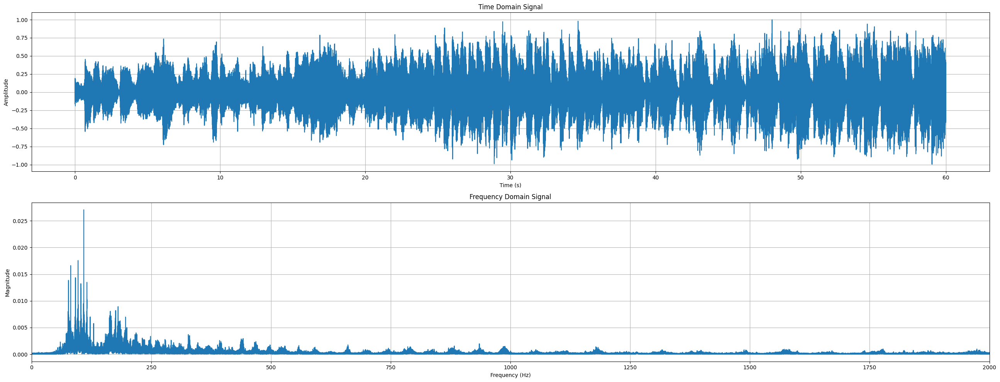

In [3]:
# time, frecuency and spectrogram graphs

fft_imperial_march = np.fft.fft(imperial_march)
freq_imperial_march = fs*np.fft.fftfreq(len(imperial_march))

fig, axs = plt.subplots(2, 1, figsize=(26, 10))
axs[0].plot(t, imperial_march)
axs[0].set_title("Time Domain Signal")
axs[0].set_xlabel("Time (s)")
axs[0].set_ylabel("Amplitude")
axs[0].grid()

axs[1].plot(freq_imperial_march[:len(freq_imperial_march)//2], (2/len(imperial_march))*np.abs(fft_imperial_march)[:len(freq_imperial_march)//2])
axs[1].set_title("Frequency Domain Signal")
axs[1].set_xlabel("Frequency (Hz)")
axs[1].set_ylabel("Magnitude")
axs[1].set_xlim(0, 2000)  # Limit x-axis to 2000 Hz for better visibility
axs[1].grid()
plt.tight_layout()
plt.show()




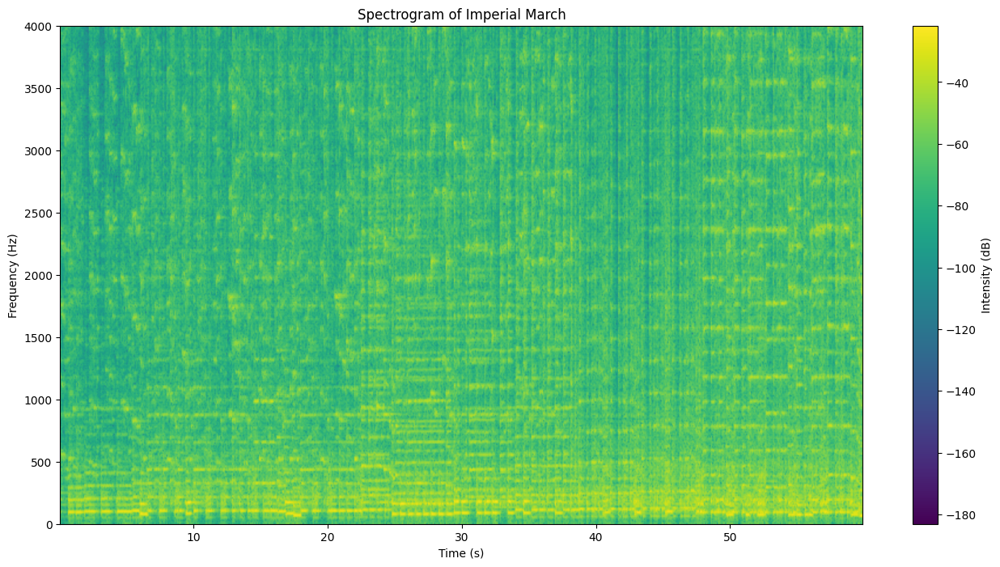

In [4]:
# Spectrogram

N = fs*100e-3                                                           # Window length of 100 ms
n_window = np.arange(0, N, 1)                                           # Create a time vector for the window

window = 25/46 - (1-(25/46))*np.cos(2*np.pi*n_window/(N-1))             # Kaiser window with beta = 25/46

# Calculate the spectrogram using the window 
f, time, Sxx = signal.spectrogram(imperial_march, fs=fs, window=window)

# Plotting the spectrogram
plt.figure(figsize=(16, 8))
plt.pcolormesh(time, f, 10 * np.log10(Sxx), shading='gouraud')
plt.title("Spectrogram of Imperial March")
plt.xlabel("Time (s)")
plt.ylabel("Frequency (Hz)")
plt.colorbar(label='Intensity (dB)')
plt.ylim(0, 4000)                                                       # Limit y-axis to 2000 Hz for better visibility
plt.show()


As observed, the majority of significant frequency components are located below $4\,\text{kHz}$. This observation aligns with the nature of the analyzed signal — an orchestral composition — where most instruments exhibit their fundamental frequencies within this range. The spectral characteristics are therefore consistent with expectations for this type of audio content.


## 1. Low-Pass Filter Design

### 1.1 Window Design

Based on the previously defined specifications, the maximum allowable ripple in the passband is given in decibels by:

$$
20\log_{10}(0.001) = -60\,\text{dB}
$$

According to the methodology discussed in class, the Hamming window provides a good balance between main-lobe width and side-lobe attenuation. The minimum number of coefficients $M$ required to achieve the desired transition bandwidth $\Delta F_m$ is determined by the following condition:

$$
\Delta \omega \leq \Delta \omega_m
$$

Using the relationship between digital and normalized frequencies:

$$
\frac{8\pi}{M} \leq \frac{2\pi \Delta F_m}{F_s}
$$

Solving for $M$:

$$
M \geq \frac{4F_s}{\Delta F_m}
$$

Substituting the values $F_s = 44100\,\text{Hz}$ and $\Delta F_m = 100\,\text{Hz}$:

$$
M \geq \frac{4 \cdot 44100}{100} = 1764
$$

To ensure the filter is causal (i.e., the impulse response is right-sided), we round up to the next odd integer:

$$
M = 1765
$$

Finally, the Hamming window function is defined as:

$$
w[n] = 0.54 - 0.46 \cos\left(\frac{2\pi n}{M - 1}\right), \quad 0 \leq n \leq M - 1
$$

This window is applied to the ideal low-pass filter impulse response to obtain a realizable finite impulse response (FIR) filter with reduced side lobes and a smoother transition band.



<function matplotlib.pyplot.show(close=None, block=None)>

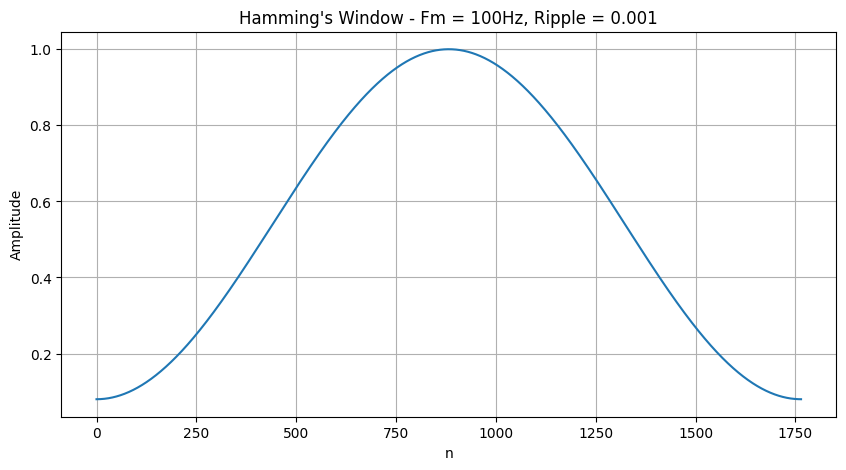

In [5]:
M = 1765
n = np.arange(0, M,1)
hamming_window = 0.54 - 0.46*np.cos(2*np.pi*n/(M-1))


plt.figure(figsize=(10, 5))
plt.plot(n,hamming_window)
plt.title("Hamming's Window - Fm = 100Hz, Ripple = 0.001")
plt.xlabel("n") 
plt.ylabel("Amplitude")
plt.grid(True)
plt.show

### 1.2 Low Pass Filter Response.

As considered at the begining, the frecuency cut on the low pass filter fixed at $250 Hz$ using the formula: 

$$H_{i}[n] = 2f_{c_{LP}}sinc(\omega_{c_{LP}}n)$$

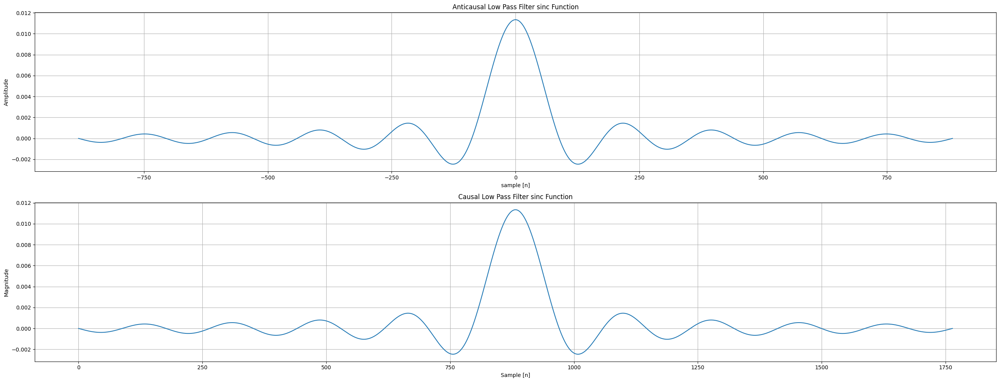

In [7]:
# Normalized cut frequency 
fc_l = 250/fs

# Normalized cut frequency in rad/s
wc_l = 2*np.pi*fc_l

n_auticausal = np.arange(-(M-1)/2, (M-1)/2 + 1, 1)

low_pass_filter = 2*fc_l * np.sinc((wc_l*n_auticausal)/np.pi)

# graph the low pass filter
fig, axs = plt.subplots(2, 1, figsize=(26, 10))
axs[0].plot(n_auticausal, low_pass_filter)
axs[0].set_title("Anticausal Low Pass Filter sinc Function")
axs[0].set_xlabel("sample [n]")
axs[0].set_ylabel("Amplitude")
axs[0].grid()

axs[1].plot(n, low_pass_filter)
axs[1].set_title("Causal Low Pass Filter sinc Function")
axs[1].set_xlabel("Sample [n]")
axs[1].set_ylabel("Magnitude")
axs[1].grid()
plt.tight_layout()
plt.show()



### 1.3 Windowing Frecuency Response of the Low-Pass filter

Obtaining the filter by multiplyng by the hamming Window:



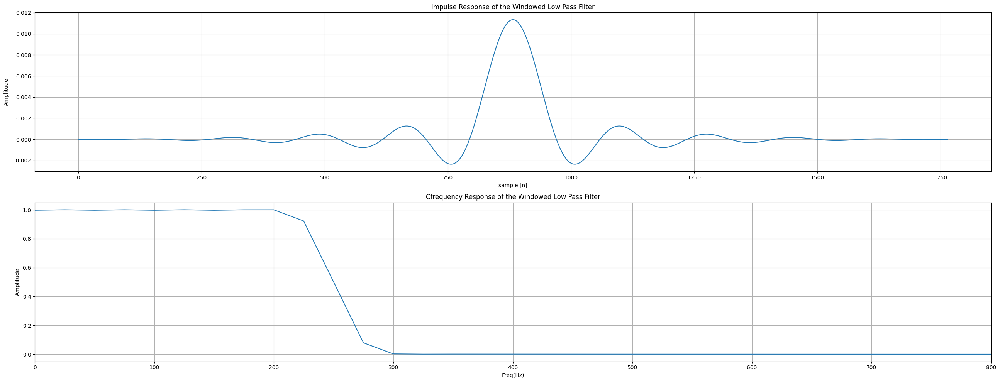

In [15]:
# Apply the Hamming window to the low pass filter
Windowed_low_pass_filter = low_pass_filter * hamming_window

# fourier transform of the windowed low pass filter
fft_lp = np.fft.fft(Windowed_low_pass_filter)
freq_lp = fs * np.fft.fftfreq(len(Windowed_low_pass_filter))

# Plot the windowed low pass filter
fig, axs = plt.subplots(2, 1, figsize=(26, 10))
axs[0].plot(n, Windowed_low_pass_filter)
axs[0].set_title("Impulse Response of the Windowed Low Pass Filter")
axs[0].set_xlabel("sample [n]")
axs[0].set_ylabel("Amplitude")
axs[0].grid()

axs[1].plot(freq_lp[:len(fft_lp)//2], np.abs(fft_lp[:len(fft_lp)//2]))
axs[1].set_title("Cfrequency Response of the Windowed Low Pass Filter")
axs[1].set_xlabel("Freq(Hz)")
axs[1].set_ylabel("Amplitude")
axs[1].set_xlim(0, 800)  # Limit x-axis to 2000 Hz for better visibility
axs[1].grid()
plt.tight_layout()
plt.show()

### 1.4 Applying the filter to the song

By a correlation is possible to see the filter on action

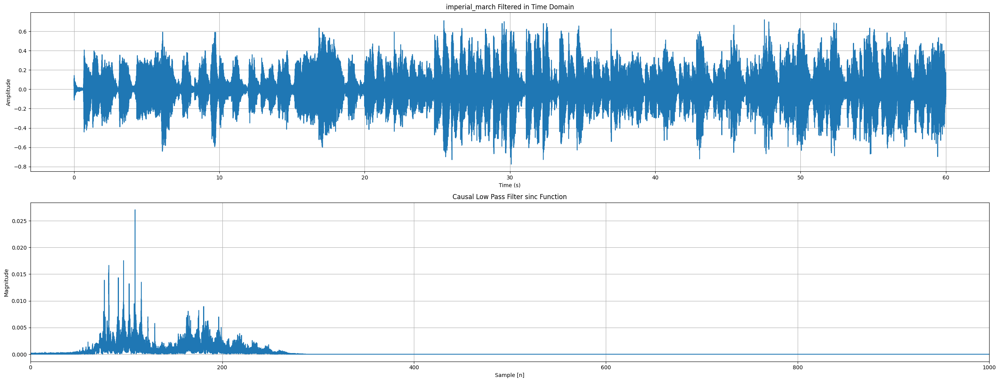

In [ ]:
# Apply the low pass filter to the audio signal
audio_filtered = np.convolve(imperial_march, Windowed_low_pass_filter, mode='same')


# graph the filtered audio signal and shows the audio player
fft_imperial_march_filtered = np.fft.fft(audio_filtered)
freq_imperial_march_filtered = fs * np.fft.fftfreq(len(audio_filtered))



fig, axs = plt.subplots(2, 1, figsize=(26, 10))
axs[0].plot(t, audio_filtered)
axs[0].set_title("imperial_march Filtered in Time Domain")
axs[0].set_xlabel("Time (s)")
axs[0].set_ylabel("Amplitude")
axs[0].grid()

axs[1].plot(freq_imperial_march_filtered[:len(freq_imperial_march_filtered)//2], (2/len(imperial_march))*np.abs(fft_imperial_march_filtered)[:len(freq_imperial_march_filtered)//2])
axs[1].set_title("Causal Low Pass Filter sinc Function")
axs[1].set_xlabel("Sample [n]")
axs[1].set_ylabel("Magnitude")
axs[1].set_xlim(0, 1000)  # Limit x-axis to 1000 Hz for better visibility
axs[1].grid()

plt.tight_layout()
plt.show()


Audio(audio_filtered, rate=fs)  # Display the audio player for the filtered signal



In [ ]:
# spearman correlation coefficient
spearman_corr = stats.spearmanr(imperial_march, audio_filtered)[0]
print(f"Spearman correlation coefficient between the original and filtered signal: {spearman_corr:.4f}")


Spearman correlation coefficient between the original and filtered signal: 0.8613
Spearman:0.8613480862365396


### 1.5 Comparing with the python predefined functions.

With $f_c = 250 Hz$ and $\alpha = 60_{dB}$


In [ ]:
nyq_rate = fs / 2.0

roll_off = 100.0
cutoff_hz = 250.0
width = roll_off/nyq_rate
ripple_db = 60.0 

N, _ = kaiserord(ripple_db, width)
lp_taps = firwin(N, cutoff_hz/nyq_rate, pass_zero=True)
lp_w, lp_h = signal.freqz(lp_taps, [1], worN=2000)

lp_aud = signal.convolve(imperial_march, lp_taps, mode='same')
Audio(data=lp_aud, rate=fs)


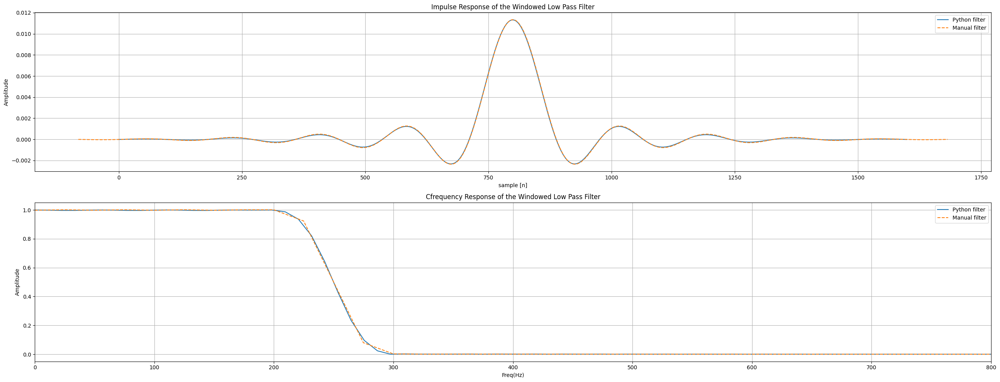

In [35]:
fig, axs = plt.subplots(2, 1, figsize=(26, 10))
axs[0].plot(lp_taps, label='Python filter')
axs[0].plot(n_auticausal+len(lp_taps)/2, Windowed_low_pass_filter, label='Manual filter', linestyle='--')
axs[0].set_title("Impulse Response of the Windowed Low Pass Filter")
axs[0].set_xlabel("sample [n]")
axs[0].set_ylabel("Amplitude")
axs[0].legend()
axs[0].grid()

axs[1].plot(nyq_rate * lp_w / np.pi, np.abs(lp_h), label='Python filter')
axs[1].plot(freq_lp[:len(fft_lp)//2], np.abs(fft_lp[:len(fft_lp)//2]), label='Manual filter', linestyle='--')
axs[1].set_title("Cfrequency Response of the Windowed Low Pass Filter")
axs[1].set_xlabel("Freq(Hz)")
axs[1].set_ylabel("Amplitude")
axs[1].legend()
axs[1].set_xlim(0, 800)  # Limit x-axis to 2000 Hz for better visibility
axs[1].grid()
plt.tight_layout()
plt.show()

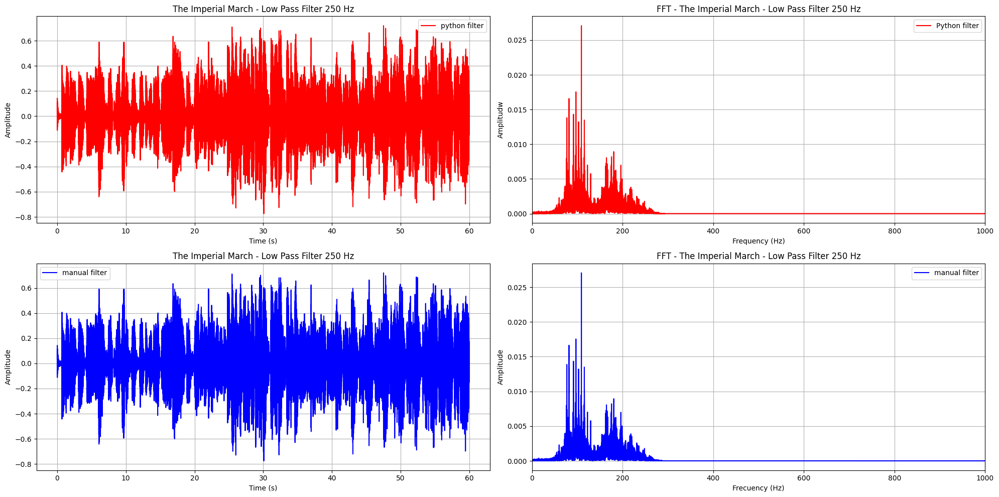

Spearman correlation coefficient between the original and filtered signal by python: 0.8617


<Figure size 640x480 with 0 Axes>

In [43]:
fft_imperial_march_lp_python = np.fft.fft(lp_aud)
freq_imperial_march_lp_python = fs*np.fft.fftfreq(len(lp_aud))

fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(20, 10))

# graph the filtered audio signal and shows the audio player
fft_imperial_march_filtered = np.fft.fft(audio_filtered)
freq_imperial_march_filtered = fs * np.fft.fftfreq(len(audio_filtered))


# Pyuthon filter
axs[0, 0].plot(t, lp_aud,color='red',label="python filter") 
axs[0, 0].set_xlabel("Time (s)")
axs[0, 0].set_ylabel("Amplitude")
axs[0, 0].set_title("The Imperial March - Low Pass Filter 250 Hz")
axs[0, 0].grid(True)
axs[0, 0].legend()

# FFT of the Python filter
axs[0, 1].plot(freq_imperial_march_lp_python[:len(freq_imperial_march_lp_python)//2], (2/len(imperial_march))*np.abs(fft_imperial_march_lp_python)[:len(fft_imperial_march_lp_python)//2],color='red',label='Python filter')
axs[0, 1].set_xlabel("Frequency (Hz)")
axs[0, 1].set_ylabel("Amplitudw")
axs[0, 1].set_title("FFT - The Imperial March - Low Pass Filter 250 Hz")
axs[0, 1].set_xlim(0, 1000)
axs[0, 1].grid(True)
axs[0, 1].legend()

axs[1,0].plot(t, audio_filtered, color='blue', label="manual filter")
axs[1,0].set_title("The Imperial March - Low Pass Filter 250 Hz")
axs[1,0].set_xlabel("Time (s)")
axs[1,0].set_ylabel("Amplitude")
axs[1,0].grid()
axs[1,0].legend()


axs[1,1].plot(freq_imperial_march_filtered[:len(freq_imperial_march_filtered)//2], (2/len(imperial_march))*np.abs(fft_imperial_march_filtered)[:len(freq_imperial_march_filtered)//2], color='blue', label='manual filter')
axs[1,1].set_title("FFT - The Imperial March - Low Pass Filter 250 Hz")
axs[1,1].set_xlabel("Frecuency (Hz)")
axs[1,1].set_ylabel("Amplitude")
axs[1,1].set_xlim(0, 1000)  # Limit x-axis to 1000 Hz for better visibility
axs[1,1].grid()
axs[1,1].legend()


plt.tight_layout()
plt.show()

plt.subplots_adjust(wspace=0.4) 

# spearman correlation coefficient
spearman_corr = stats.spearmanr(imperial_march, lp_aud)[0]
print(f"Spearman correlation coefficient between the original and filtered signal by python: {spearman_corr:.4f}")



### 1.6 Conclusion.


Maverick poné una conclusión aqui